In [2]:
import torchaudio
import librosa
import numpy as np
import os


data_path = r"D:\dataset\archive\KAGGLE\AUDIO\REAL"

# Function to load an audio
def load_audio(file_path, target_sample_rate=16000):
    waveform, sample_rate = librosa.load(file_path, sr=target_sample_rate)
    return waveform


example_audio = load_audio(os.path.join(data_path, "biden-original.wav"))
print(example_audio.shape)  # Should print shape like (N,)

(9600048,)


In [3]:
import torchaudio
import librosa
import numpy as np
import os


data_path = r"D:\dataset\archive\KAGGLE\AUDIO\REAL"

# Function to load an audio file
def load_audio(file_path, target_sample_rate=16000):
    waveform, sample_rate = librosa.load(file_path, sr=target_sample_rate)
    return waveform

# Loaded a specific audio file 
example_audio_path = os.path.join(data_path, "biden-original.wav")


if os.path.exists(example_audio_path):
    example_audio = load_audio(example_audio_path)
    print("Shape:", example_audio.shape)
else:
    print("File not found:", example_audio_path)

Shape: (9600048,)


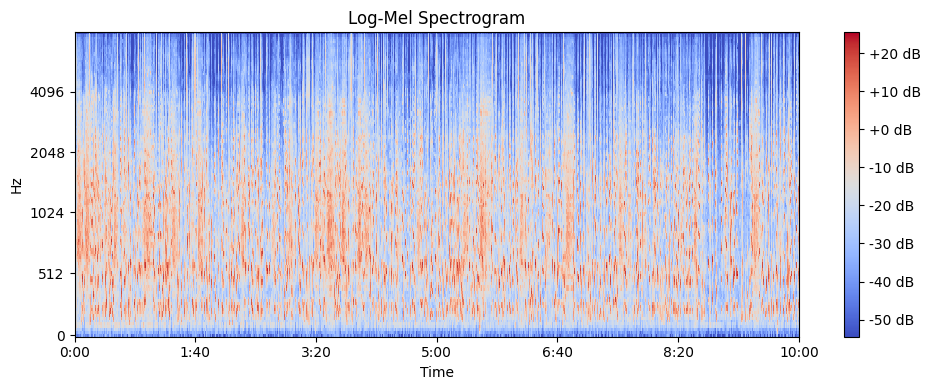

In [4]:
import librosa.display
import matplotlib.pyplot as plt

def plot_mel_spectrogram(audio, sr):
    mel_spec = librosa.feature.melspectrogram(y=audio, sr=sr, n_mels=128)
    log_mel_spec = librosa.power_to_db(mel_spec)

    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spec, sr=sr, x_axis='time', y_axis='mel')
    plt.title("Log-Mel Spectrogram")
    plt.colorbar(format='%+2.0f dB')
    plt.tight_layout()
    plt.show()

plot_mel_spectrogram(example_audio, 16000)

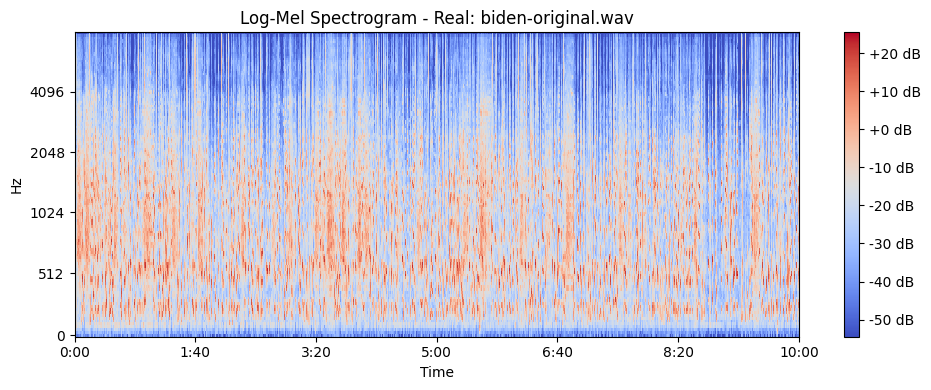

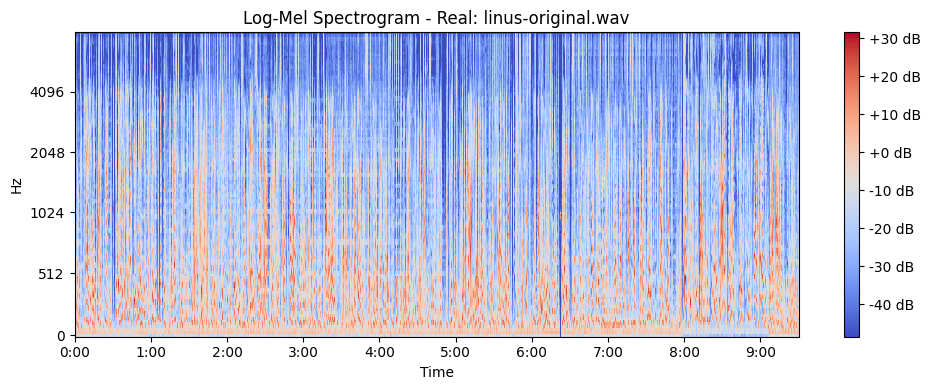

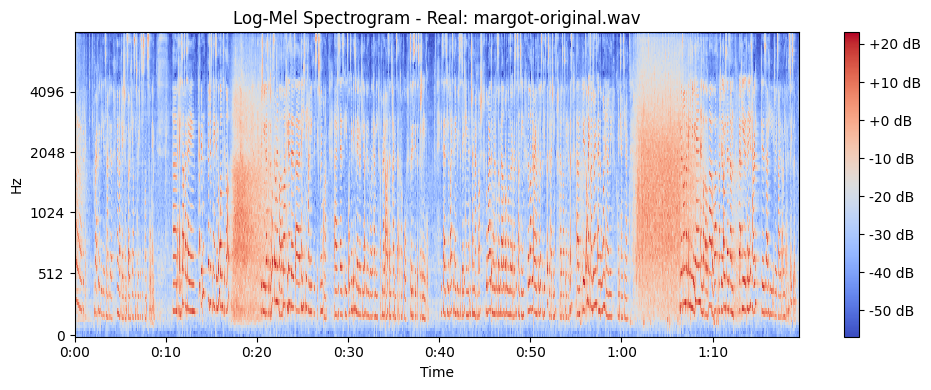

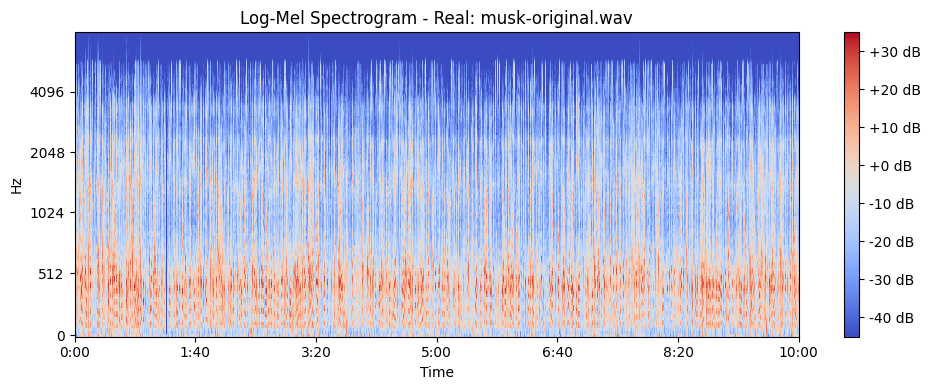

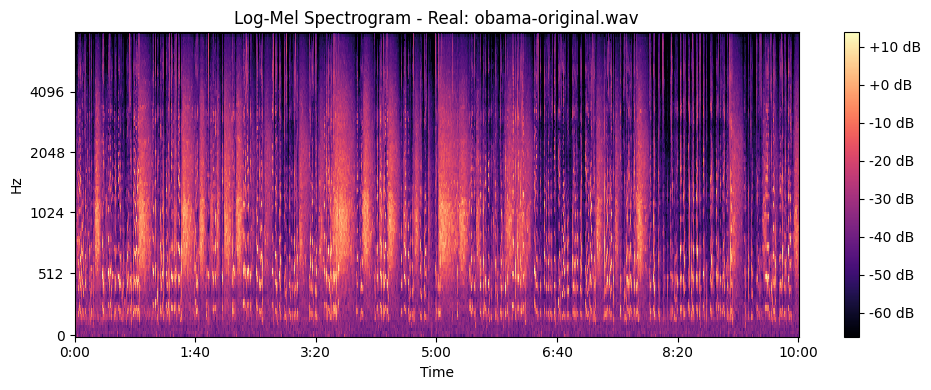

...

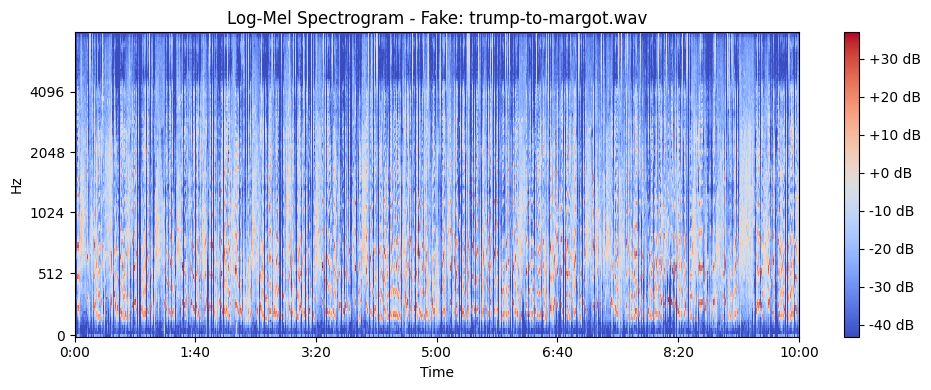

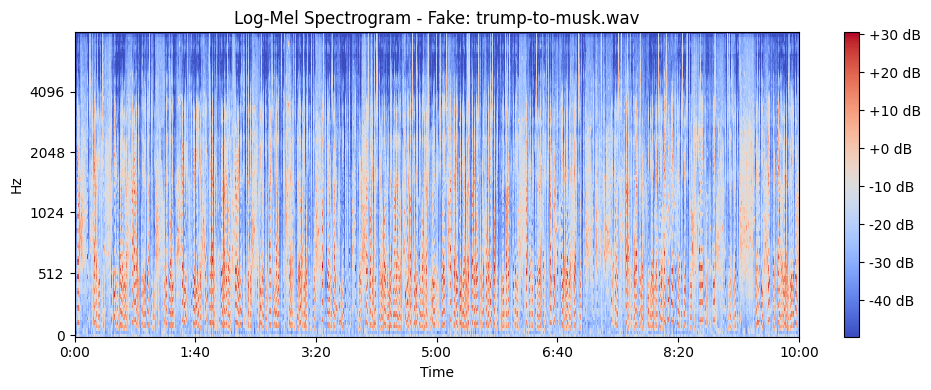

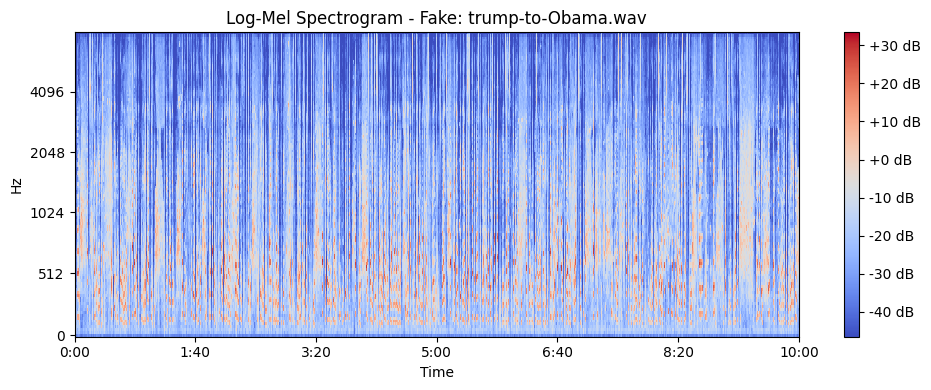

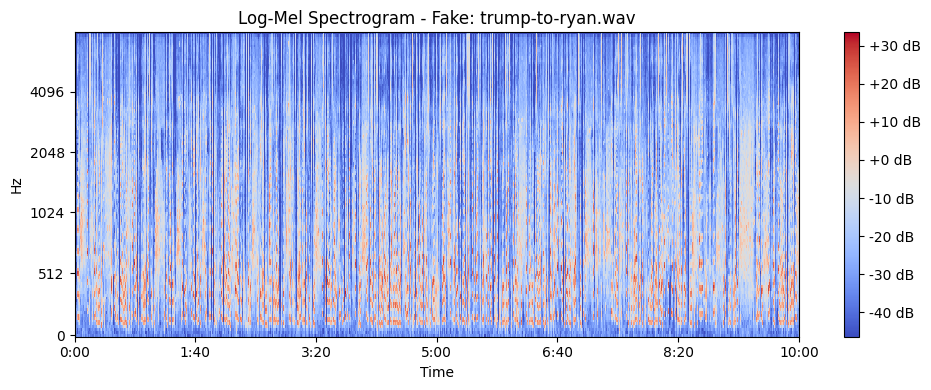

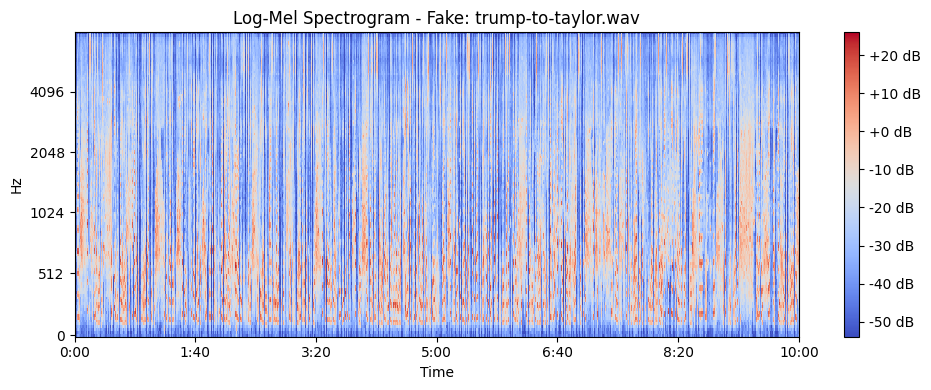

In [5]:
import os
import librosa
import librosa.display
import matplotlib.pyplot as plt


real_path = r'D:\dataset\archive\KAGGLE\AUDIO\REAL'
fake_path = r'D:\dataset\archive\KAGGLE\AUDIO\FAKE'

# Combined both folders into one list
all_files = []
labels = []

for file in os.listdir(real_path):
    if file.endswith('.wav'):
        all_files.append(os.path.join(real_path, file))
        labels.append(0)  # Label 0 for real

for file in os.listdir(fake_path):
    if file.endswith('.wav'):
        all_files.append(os.path.join(fake_path, file))
        labels.append(1)  # Label 1 for fake

# Plot mel spectrogram for each file
def plot_mel_spectrogram(audio, sr, title):
    mel_spec = librosa.feature.melspectrogram(y=audio, sr=sr, n_mels=128)
    log_mel_spec = librosa.power_to_db(mel_spec)

    plt.figure(figsize=(10, 4))
    librosa.display.specshow(log_mel_spec, sr=sr, x_axis='time', y_axis='mel')
    plt.title(f"Log-Mel Spectrogram - {title}")
    plt.colorbar(format='%+2.0f dB')
    plt.tight_layout()
    plt.show()

# Loopping over all audio files
for idx, file_path in enumerate(all_files):
    audio, sr = librosa.load(file_path, sr=16000)
    label = "Real" if labels[idx] == 0 else "Fake"
    plot_mel_spectrogram(audio, sr, f"{label}: {os.path.basename(file_path)}")

In [6]:
import os
import librosa
import numpy as np

real_path = r'D:\dataset\archive\KAGGLE\AUDIO\REAL'
fake_path = r'D:\dataset\archive\KAGGLE\AUDIO\FAKE'

X = []
y = []

fixed_shape = (128, 400)  #

def extract_and_pad_mel(file_path, max_len=400):
    audio, sr = librosa.load(file_path, sr=16000)
    mel_spec = librosa.feature.melspectrogram(y=audio, sr=sr, n_mels=128)
    log_mel_spec = librosa.power_to_db(mel_spec)

    # truncated to fixed shape
    if log_mel_spec.shape[1] < max_len:
        pad_width = max_len - log_mel_spec.shape[1]
        log_mel_spec = np.pad(log_mel_spec, ((0,0), (0, pad_width)), mode='constant')
    else:
        log_mel_spec = log_mel_spec[:, :max_len]

    return log_mel_spec
    # Processed real audio
for file in os.listdir(real_path):
    if file.endswith('.wav'):
        path = os.path.join(real_path, file)
        mel = extract_and_pad_mel(path)
        X.append(mel)
        y.append(0)

# Processed fake audio
for file in os.listdir(fake_path):
    if file.endswith('.wav'):
        path = os.path.join(fake_path, file)
        mel = extract_and_pad_mel(path)
        X.append(mel)
        y.append(1)

X = np.array(X)
y = np.array(y)

print("X shape:", X.shape)
print("y shape:", y.shape)

X shape: (64, 128, 400)
y shape: (64,)


In [7]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split

# Converted to PyTorch 
X = torch.tensor(X).unsqueeze(1).float()  # Add channel dim (N, 1, 128, 400)
y = torch.tensor(y).long()

# Train/Val split
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

# Dataset and Dataloader
class AudioDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
    def __len__(self):
        return len(self.X)
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

train_ds = AudioDataset(X_train, y_train)
val_ds = AudioDataset(X_val, y_val)

train_loader = DataLoader(train_ds, batch_size=8, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=8)

# Simple CNN Model
class AudioCNN(nn.Module):
    def __init__(self):
        super(AudioCNN, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(1, 16, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2),  # (64, 64, 200)

            nn.Conv2d(16, 32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2),  # (32, 32, 100)
        )
        self.fc = nn.Sequential(
            nn.Flatten(),
            nn.Linear(32 * 32 * 100, 64),
            nn.ReLU(),
            nn.Linear(64, 2)  # 2 classes: real and fake
        )

    def forward(self, x):
        x = self.conv(x)
        x = self.fc(x)
        return x

model = AudioCNN()
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Training setup
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
for epoch in range(10):
    model.train()
    total_loss = 0
    for inputs, targets in train_loader:
        inputs, targets = inputs.to(device), targets.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    
    print(f"Epoch {epoch+1} | Loss: {total_loss:.4f}")
    
    # Evaluate
model.eval()
correct = 0
total = 0
with torch.no_grad():
    for inputs, targets in val_loader:
        inputs, targets = inputs.to(device), targets.to(device)
        outputs = model(inputs)
        _, predicted = torch.max(outputs, 1)
        total += targets.size(0)
        correct += (predicted == targets).sum().item()

print(f"Validation Accuracy: {100 * correct / total:.2f}%")

Epoch 1 | Loss: 170.3985
Epoch 2 | Loss: 16.6187
Epoch 3 | Loss: 18.8983
Epoch 4 | Loss: 5.1163
Epoch 5 | Loss: 3.9281
Epoch 6 | Loss: 1.0858
Epoch 7 | Loss: 1.0204
Epoch 8 | Loss: 1.8534
Epoch 9 | Loss: 0.6788
Epoch 10 | Loss: 0.9384
Validation Accuracy: 84.62%
